In [1]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import math

In [2]:
ghost_1 = cv.imread('P5/ghost_1.jpg')
ghost_2 = cv.imread('P5/ghost_2.jpg', cv.IMREAD_GRAYSCALE)
ghost_3 = cv.imread('P5/ghost_3.jpg', cv.IMREAD_GRAYSCALE)
ghost_4 = cv.imread('P5/ghost_4.jpg', cv.IMREAD_GRAYSCALE)

ghost_1 = cv.imread('P5/ghost_1.png')
ghost_1 = cv.cvtColor(ghost_1, cv.COLOR_BGR2GRAY)

ghost_2 = cv.imread('P5/ghost_2.png')
ghost_2 = cv.cvtColor(ghost_2, cv.COLOR_BGR2GRAY)

ghost_3 = cv.imread('P5/ghost_3.png')
ghost_3 = cv.cvtColor(ghost_3, cv.COLOR_BGR2GRAY)

ghost_4 = cv.imread('P5/ghost_4.png')
ghost_4 = cv.cvtColor(ghost_4, cv.COLOR_BGR2GRAY)

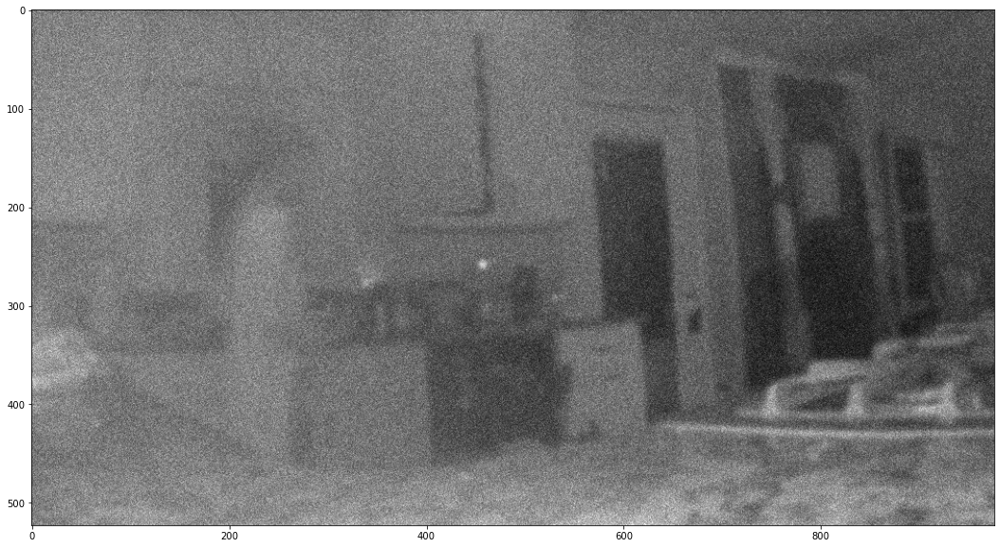

In [7]:
plt.figure(figsize=(20,10))
plt.imshow(ghost_1,cmap='gray')

In [20]:

def imhist(im):
  # calculates normalized histogram of an image
    m, n = im.shape
    h = [0.0] * 256
    for i in range(m):
        for j in range(n):
            h[im[i, j]]+=1
    return np.array(h)/(m*n)

def cumsum(h):
    # finds cumulative sum of a numpy array, list
    return [sum(h[:i+1]) for i in range(len(h))]

def histeq(im):
    #calculate Histogram
    h = imhist(im)
    cdf = np.array(cumsum(h)) #cumulative distribution function
    sk = np.uint8(255 * cdf) #finding transfer function values
    s1, s2 = im.shape
    Y = np.zeros_like(im)
    # applying transfered values for each pixels
    for i in range(0, s1):
        for j in range(0, s2):
            Y[i, j] = sk[im[i, j]]
    H = imhist(Y)
    #return transformed image, original and new istogram, 
    # and transform function
    return Y 

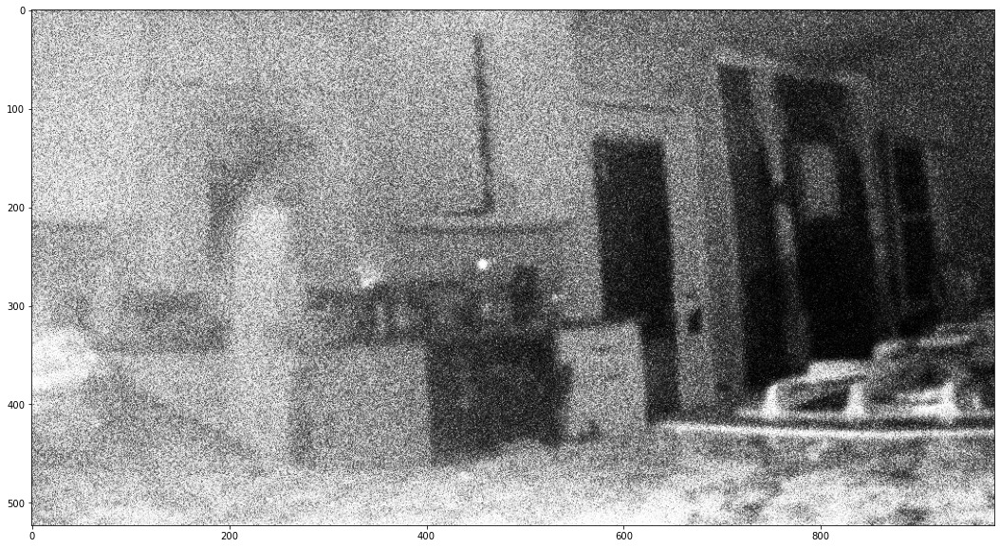

In [9]:
plt.figure(figsize=(20,10))
plt.imshow(histeq(ghost_1),cmap='gray')

In [25]:
x = 100
y = 100

boundry_list = []


gray_img = ghost_1
for r in range(0, gray_img.shape[0], x):
    for c in range(0, gray_img.shape[1], y):
        window = gray_img[r:r + x, c:c + y]
        transform_map = histeq(window)
        eq_gray_img_array = np.reshape(np.asarray(transform_map), window.shape)
        gray_img[r:r + x, c:c + y] = eq_gray_img_array
        boundry_list.append([[r,c],[r,c+y],[r+x,c],[r+x,c+y]])

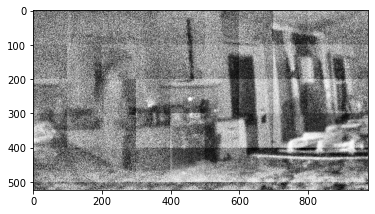

In [11]:
plt.imshow(gray_img,cmap='gray')

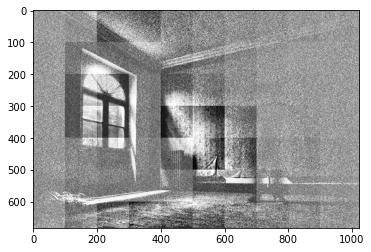

In [27]:
x = 100
y = 100

boundry_list = []


gray_img = ghost_2
for r in range(0, gray_img.shape[0], x):
    for c in range(0, gray_img.shape[1], y):
        window = gray_img[r:r + x, c:c + y]
        transform_map = histeq(window)
        eq_gray_img_array = np.reshape(np.asarray(transform_map), window.shape)
        gray_img[r:r + x, c:c + y] = eq_gray_img_array
        boundry_list.append([[r,c],[r,c+y],[r+x,c],[r+x,c+y]])
        
plt.imshow(gray_img,cmap='gray')

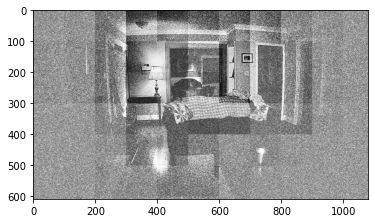

In [44]:
x = 100
y = 100

boundry_list = []


gray_img = ghost_3
for r in range(0, gray_img.shape[0], x):
    for c in range(0, gray_img.shape[1], y):
        window = gray_img[r:r + x, c:c + y]
        transform_map = histeq(window)
        eq_gray_img_array = np.reshape(np.asarray(transform_map), window.shape)
        gray_img[r:r + x, c:c + y] = eq_gray_img_array
        boundry_list.append([[r,c],[r,c+y],[r+x,c],[r+x,c+y]])
        
plt.imshow(gray_img,cmap='gray')

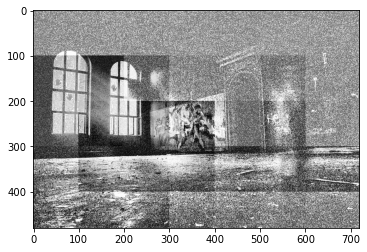

In [49]:
x = 100
y = 100

boundry_list = []


gray_img = ghost_4
for r in range(0, gray_img.shape[0], x):
    for c in range(0, gray_img.shape[1], y):
        window = gray_img[r:r + x, c:c + y]
        transform_map = histeq(window)
        eq_gray_img_array = np.reshape(np.asarray(transform_map), window.shape)
        gray_img[r:r + x, c:c + y] = eq_gray_img_array
        boundry_list.append([[r,c],[r,c+y],[r+x,c],[r+x,c+y]])
        
plt.imshow(gray_img,cmap='gray')

# part b

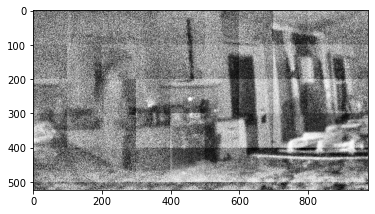

In [16]:
bilinear_img = BiLinear_interpolation(gray_img, 523, 976)
plt.imshow(bilinear_img,cmap='gray')

In [12]:
import numpy as np
from math import floor, ceil


def interpolate(first_value: float, second_value: float, ratio: float) -> float:
    """Interpolate with a linear weighted sum."""
    return first_value * (1 - ratio) + second_value * ratio


def get_array_value(x: int, y: int, array: np.ndarray):
    """Returns the value of the array at position x,y."""
    return array[y, x]


def bilinear_interpolation(x: float, y: float, img: np.ndarray) -> float:
    """Returns the bilinear interpolation of a pixel in the image.
    :param x: x-position to interpolate
    :param y: y-position to interpolate
    :param img: image, where the pixel should be interpolated
    :returns: value of the interpolated pixel
    """
    if x < 0 or y < 0:
        raise ValueError("x and y pixel position have to be positive!")
    if img.shape[1] - 1 < x or img.shape[0] - 1 < y:
        raise ValueError(
            "x and y pixel position have to be smaller than image" "dimensions."
        )

    x_rounded_up = int(ceil(x))
    x_rounded_down = int(floor(x))
    y_rounded_up = int(ceil(y))
    y_rounded_down = int(floor(y))

    ratio_x = x - x_rounded_down
    ratio_y = y - y_rounded_down

    interpolate_x1 = interpolate(
        get_array_value(x_rounded_down, y_rounded_down, img),
        get_array_value(x_rounded_up, y_rounded_down, img),
        ratio_x,
    )
    interpolate_x2 = interpolate(
        get_array_value(x_rounded_down, y_rounded_up, img),
        get_array_value(x_rounded_up, y_rounded_up, img),
        ratio_x,
    )
    interpolate_y = interpolate(interpolate_x1, interpolate_x2, ratio_y)

    return interpolate_y


In [ ]:
#image = np.arange(0, 9).reshape((3, 3))
image = bilinear_interpolation(0.5, 1.5, image)

for r in range(0, gray_img.shape[0], x):
    for c in range(0, gray_img.shape[1], y):
        gray_img[r, c:c + y] = bilinear_interpolation(0.5, 1.5, image)
        boundry_list.append([[r,c],[r,c+y],[r+x,c],[r+x,c+y]])

In [36]:
def get_bilinear_intensity(img, y, x):
        """Returns intensity of img at [y, x] using bilinear interpolation.
        Arguments
        ---------
        img : np.ndarray; (height_img, width_img); np.uint8
            Grayscale image to resize.
        y, x : float
            Coordinates in image where intensity is to be computed.
        
        Returns
        -------
        intensity_interpolated : int
            computed interpolated intensity value at [y,x].
        """
        # extract corner coordinates
        y_top = int(y)  # top in image representation is low in y value
        x_left = int(x)
        y_bottom = min(y_top+4, img.shape[0]-4)
        x_right = min(x_left+4, img.shape[1]-4)

        # extract fractional component
        y_frac = y - y_top
        x_frac = x - x_left

        # pixel values at corner
        intensity_top_left = img[y_top, x_left]
        intensity_top_right = img[y_top, x_right]
        intensity_bottom_left = img[y_bottom, x_left]
        intensity_bottom_right = img[y_bottom, x_right]

        # bilinear interpolation of intensity values based on fractional components
        intensity_interpolated_top = intensity_top_left * (1-x_frac) \
            + intensity_top_right * x_frac
        intensity_interpolated_bottom = intensity_bottom_left * (1-x_frac) \
            + intensity_bottom_right * x_frac
        intensity_interpolated = intensity_interpolated_top * (1-y_frac) \
            + intensity_interpolated_bottom * y_frac

        return intensity_interpolated

In [50]:
img_copy = np.empty(gray_img.shape)
for i in range(0,gray_img.shape[0],100):
    for j in range(0,gray_img.shape[1]):
        img_copy[i,j] = 255

In [51]:
for i in range(0,gray_img.shape[0]):
    for j in range(0,gray_img.shape[1],100):
        img_copy[i,j] = 255

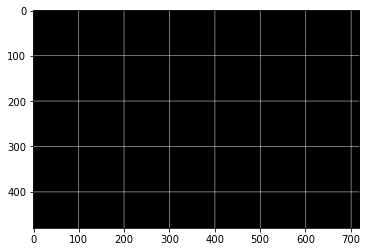

In [52]:
plt.imshow(img_copy,cmap='gray')

In [38]:
import numpy as np

def bilinear_interpolate_numpy(im, x, y):
    x0 = np.floor(x).astype(int)
    x1 = x0 + 5
    y0 = np.floor(y).astype(int)
    y1 = y0 + 5

    x0 = np.clip(x0, 0, im.shape[1]-1)
    x1 = np.clip(x1, 0, im.shape[1]-1)
    y0 = np.clip(y0, 0, im.shape[0]-1)
    y1 = np.clip(y1, 0, im.shape[0]-1)

    Ia = im[ y0, x0 ]
    Ib = im[ y1, x0 ]
    Ic = im[ y0, x1 ]
    Id = im[ y1, x1 ]

    wa = (x1-x) * (y1-y)
    wb = (x1-x) * (y-y0)
    wc = (x-x0) * (y1-y)
    wd = (x-x0) * (y-y0)

    return (Ia.T*wa).T + (Ib.T*wb).T + (Ic.T*wc).T + (Id.T*wd).T

In [62]:
gray_img_copy = gray_img.copy()
for i in range(gray_img.shape[0]):
    for j in range(gray_img.shape[1]):
        if img_copy[i,j] == 255:
            if i-1>0 and i+1<gray_img.shape[0] and j-1>0 and j+1< gray_img.shape[1]:
                value = bilinear_interpolate_numpy(img,i,j)
                #value = (gray_img[i-1,j]+gray_img[i+1,j]+gray_img[i,j-1]+gray_img[i,j+1])
                gray_img_copy[i,j] = value[0]+value[1]+value[0]/3

            

C:\Users\Lenovo\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in ubyte_scalars
  
C:\Users\Lenovo\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in short_scalars
  


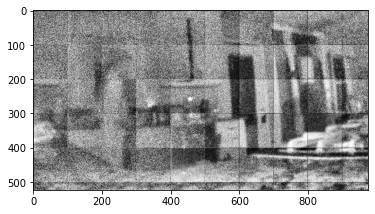

In [63]:
plt.imshow(gray_img_copy,cmap='gray')

C:\Users\Lenovo\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in ubyte_scalars
  


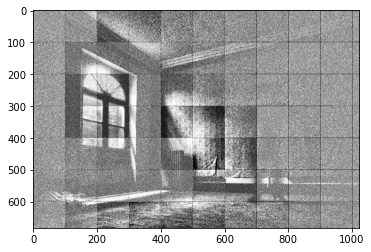

In [41]:
gray_img_copy = gray_img.copy()
for i in range(gray_img.shape[0]):
    for j in range(gray_img.shape[1]):
        if img_copy[i,j] == 255:
            
            value = bilinear_interpolate_numpy(img,i,j)
            #value = (gray_img[i-1,j]+gray_img[i+1,j]+gray_img[i,j-1]+gray_img[i,j+1])
            gray_img_copy[i,j] = value[0]+value[1]+value[0]/3
plt.imshow(gray_img_copy,cmap='gray')

C:\Users\Lenovo\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in ubyte_scalars
  


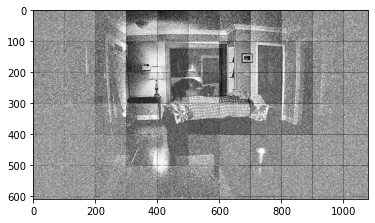

In [48]:
gray_img_copy = gray_img.copy()
for i in range(gray_img.shape[0]):
    for j in range(gray_img.shape[1]):
        if img_copy[i,j] == 255:
            
            value = bilinear_interpolate_numpy(img,i,j)
            #value = (gray_img[i-1,j]+gray_img[i+1,j]+gray_img[i,j-1]+gray_img[i,j+1])
            gray_img_copy[i,j] = value[0]+value[1]+value[0]/3
plt.imshow(gray_img_copy,cmap='gray')

C:\Users\Lenovo\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in ubyte_scalars
  


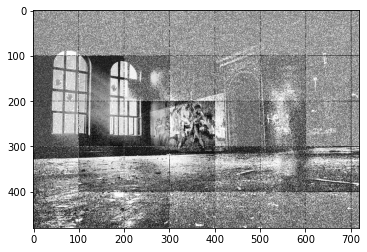

In [53]:
gray_img_copy = gray_img.copy()
for i in range(gray_img.shape[0]):
    for j in range(gray_img.shape[1]):
        if img_copy[i,j] == 255:
            
            value = bilinear_interpolate_numpy(img,i,j)
            #value = (gray_img[i-1,j]+gray_img[i+1,j]+gray_img[i,j-1]+gray_img[i,j+1])
            gray_img_copy[i,j] = value[0]+value[1]+value[0]/3
plt.imshow(gray_img_copy,cmap='gray')

# i interpolate bouandaries in many ways but borders didn't fade completely

# part c

...Make the LUT...
(544, 992)
...Making the Histogram...
17 31 (17, 31, 128)
...Clipping the Histogram...
...Mapping the Histogram...
...interpolation...


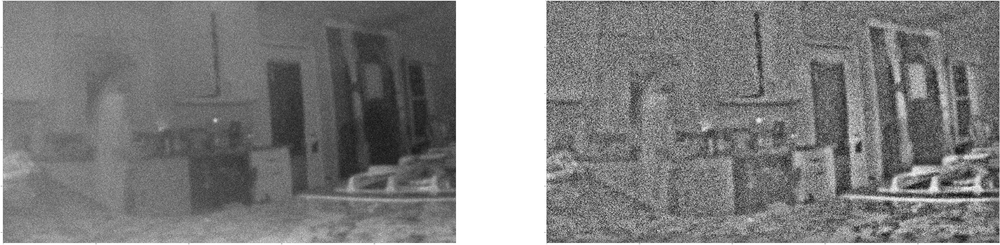

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io

#INTERPOLATION FUNCTION
def interpolate(subBin,LU,RU,LB,RB,subX,subY):
    subImage = np.zeros(subBin.shape)
    num = subX*subY
    for i in range(subX):
        inverseI = subX-i
        for j in range(subY):
            inverseJ = subY-j
            val = subBin[i,j].astype(int)
            subImage[i,j] = np.floor((inverseI*(inverseJ*LU[val] + j*RU[val])+ i*(inverseJ*LB[val] + j*RB[val]))/float(num))
    return subImage

#CLAHE FUNCTION
#ALL UTILITY FUNCTIONS COMBINED INTO ONE FUNCTION
def clahe(img,clipLimit,nrBins=128,nrX=0,nrY=0):
    '''img - Input image
       clipLimit - Normalized clipLimit. Higher value gives more contrast
       nrBins - Number of graylevel bins for histogram("dynamic range")
       nrX - Number of contextial regions in X direction
       nrY - Number of Contextial regions in Y direction'''
    h,w = img.shape
    if clipLimit==1:
        return
    nrBins = max(nrBins,128)
    if nrX==0:
        #Taking dimensions of each contextial region to be a square of 32X32
        xsz = 32
        ysz = 32
        nrX = np.ceil(h/xsz).astype(int)#240
        #Excess number of pixels to get an integer value of nrX and nrY
        excX= int(xsz*(nrX-h/xsz))
        nrY = np.ceil(w/ysz).astype(int)#320
        excY= int(ysz*(nrY-w/ysz))
        #Pad that number of pixels to the image
        if excX!=0:
            img = np.append(img,np.zeros((excX,img.shape[1])).astype(int),axis=0)
        if excY!=0:
            img = np.append(img,np.zeros((img.shape[0],excY)).astype(int),axis=1)
    else:
        xsz = round(h/nrX)
        ysz = round(w/nrY)
    
    nrPixels = xsz*ysz
    xsz2 = round(xsz/2)
    ysz2 = round(ysz/2)
    claheimg = np.zeros(img.shape)
    
    if clipLimit > 0:
        clipLimit = max(1,clipLimit*xsz*ysz/nrBins)
    else:
        clipLimit = 50
    
    #makeLUT
    print("...Make the LUT...")
    minVal = 0 #np.min(img)
    maxVal = 255 #np.max(img)
    
    #maxVal1 = maxVal + np.maximum(np.array([0]),minVal) - minVal
    #minVal1 = np.maximum(np.array([0]),minVal)
    
    binSz = np.floor(1+(maxVal-minVal)/float(nrBins))
    LUT = np.floor((np.arange(minVal,maxVal+1)-minVal)/float(binSz))
    
    #BACK TO CLAHE
    bins = LUT[img]
    print(bins.shape)
    #makeHistogram
    print("...Making the Histogram...")
    hist = np.zeros((nrX,nrY,nrBins))
    print(nrX,nrY,hist.shape)
    for i in range(nrX):
        for j in range(nrY):
            bin_ = bins[i*xsz:(i+1)*xsz,j*ysz:(j+1)*ysz].astype(int)
            for i1 in range(xsz):
                for j1 in range(ysz):
                    hist[i,j,bin_[i1,j1]]+=1
    
    #clipHistogram
    print("...Clipping the Histogram...")
    if clipLimit>0:
        for i in range(nrX):
            for j in range(nrY):
                nrExcess = 0
                for nr in range(nrBins):
                    excess = hist[i,j,nr] - clipLimit
                    if excess>0:
                        nrExcess += excess
                
                binIncr = nrExcess/nrBins
                upper = clipLimit - binIncr
                for nr in range(nrBins):
                    if hist[i,j,nr] > clipLimit:
                        hist[i,j,nr] = clipLimit
                    else:
                        if hist[i,j,nr]>upper:
                            nrExcess += upper - hist[i,j,nr]
                            hist[i,j,nr] = clipLimit
                        else:
                            nrExcess -= binIncr
                            hist[i,j,nr] += binIncr
                
                if nrExcess > 0:
                    stepSz = max(1,np.floor(1+nrExcess/nrBins))
                    for nr in range(nrBins):
                        nrExcess -= stepSz
                        hist[i,j,nr] += stepSz
                        if nrExcess < 1:
                            break
    
    #mapHistogram
    print("...Mapping the Histogram...")
    map_ = np.zeros((nrX,nrY,nrBins))
    #print(map_.shape)
    scale = (maxVal - minVal)/float(nrPixels)
    for i in range(nrX):
        for j in range(nrY):
            sum_ = 0
            for nr in range(nrBins):
                sum_ += hist[i,j,nr]
                map_[i,j,nr] = np.floor(min(minVal+sum_*scale,maxVal))
    
    #BACK TO CLAHE
    #INTERPOLATION
    print("...interpolation...")
    xI = 0
    for i in range(nrX+1):
        if i==0:
            subX = int(xsz/2)
            xU = 0
            xB = 0
        elif i==nrX:
            subX = int(xsz/2)
            xU = nrX-1
            xB = nrX-1
        else:
            subX = xsz
            xU = i-1
            xB = i
        
        yI = 0
        for j in range(nrY+1):
            if j==0:
                subY = int(ysz/2)
                yL = 0
                yR = 0
            elif j==nrY:
                subY = int(ysz/2)
                yL = nrY-1
                yR = nrY-1
            else:
                subY = ysz
                yL = j-1
                yR = j
            UL = map_[xU,yL,:]
            UR = map_[xU,yR,:]
            BL = map_[xB,yL,:]
            BR = map_[xB,yR,:]
            #print("CLAHE vals...")
            subBin = bins[xI:xI+subX,yI:yI+subY]
            #print("clahe subBin shape: ",subBin.shape)
            subImage = interpolate(subBin,UL,UR,BL,BR,subX,subY)
            claheimg[xI:xI+subX,yI:yI+subY] = subImage
            yI += subY
        xI += subX
    
    if excX==0 and excY!=0:
        return claheimg[:,:-excY]
    elif excX!=0 and excY==0:
        return claheimg[:-excX,:]
    elif excX!=0 and excY!=0:
        return claheimg[:-excX,:-excY]
    else:
        return claheimg
      
image = ghost_1
clahe_img = clahe(image,8,0,0)
#clipLimit = 8 gave decent results on eyePACs Dataset
#and setting xsz and ysz = 32
#and calculating nrX and nrY

fig,axs = plt.subplots(1,2,figsize=(200,100))
axs[0].imshow(image,cmap='gray')
axs[1].imshow(clahe_img,cmap='gray')

img1 = clahe_img
plt.show()

...Make the LUT...
(704, 1024)
...Making the Histogram...
22 32 (22, 32, 128)
...Clipping the Histogram...
...Mapping the Histogram...
...interpolation...


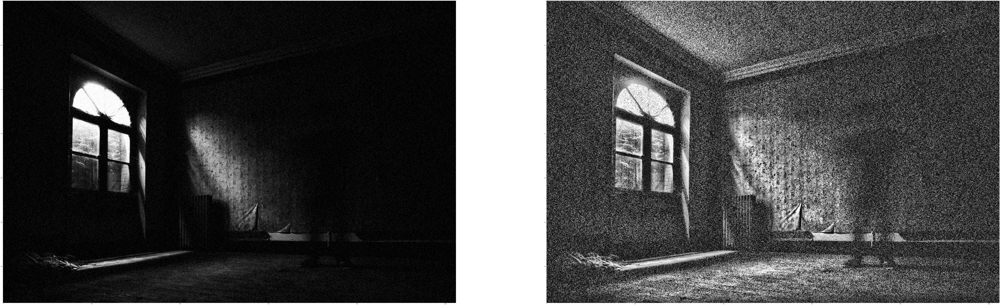

In [4]:
image = ghost_2
clahe_img = clahe(image,8,0,0)
#clipLimit = 8 gave decent results on eyePACs Dataset
#and setting xsz and ysz = 32
#and calculating nrX and nrY

fig,axs = plt.subplots(1,2,figsize=(200,100))
axs[0].imshow(image,cmap='gray')
axs[1].imshow(clahe_img,cmap='gray')
plt.show()

img2 = clahe_img

...Make the LUT...
(608, 1088)
...Making the Histogram...
19 34 (19, 34, 128)
...Clipping the Histogram...
...Mapping the Histogram...
...interpolation...


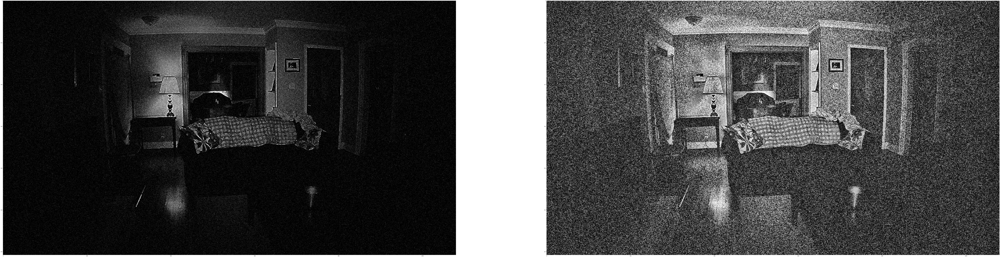

In [5]:
image = ghost_3
clahe_img = clahe(image,8,0,0)
#clipLimit = 8 gave decent results on eyePACs Dataset
#and setting xsz and ysz = 32
#and calculating nrX and nrY

fig,axs = plt.subplots(1,2,figsize=(200,100))
axs[0].imshow(image,cmap='gray')
axs[1].imshow(clahe_img,cmap='gray')
plt.show()

img3 = clahe_img

...Make the LUT...
(480, 736)
...Making the Histogram...
15 23 (15, 23, 128)
...Clipping the Histogram...
...Mapping the Histogram...
...interpolation...


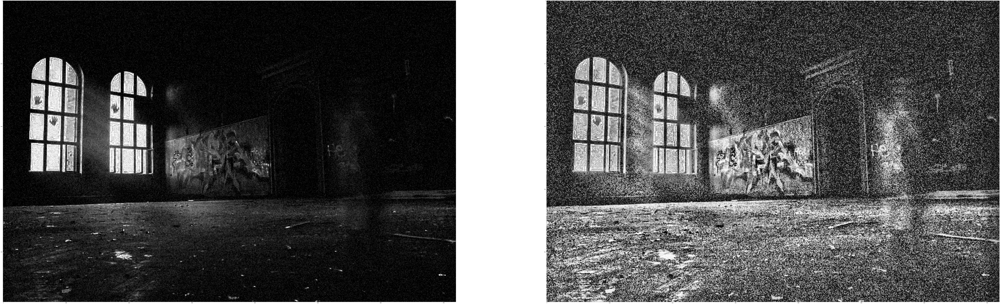

In [6]:
image = ghost_4
clahe_img = clahe(image,8,0,0)
#clipLimit = 8 gave decent results on eyePACs Dataset
#and setting xsz and ysz = 32
#and calculating nrX and nrY

fig,axs = plt.subplots(1,2,figsize=(200,100))
axs[0].imshow(image,cmap='gray')
axs[1].imshow(clahe_img,cmap='gray')
plt.show()

img4 = clahe_img

# part d

In [7]:
def _local_median(img, x, y, k):
    """
    Computes median for k-neighborhood of img[x,y]
    """
    flat = img[x-k : x+k+1, y-k : y+k+1].flatten()
    flat.sort()
    return flat[len(flat)//2]


def median(img, k=3):
    """
    Changes every pixel to the median of its neighboors
    """
    res = np.copy(img)

    for x in range(img.shape[0]):
        for y in range(img.shape[1]):
            if (x-k >= 0 and x+k < img.shape[0]) and \
                    (y-k >= 0 and y+k < img.shape[1]):
                res[x, y] = _local_median(img, x, y, k)

    return res

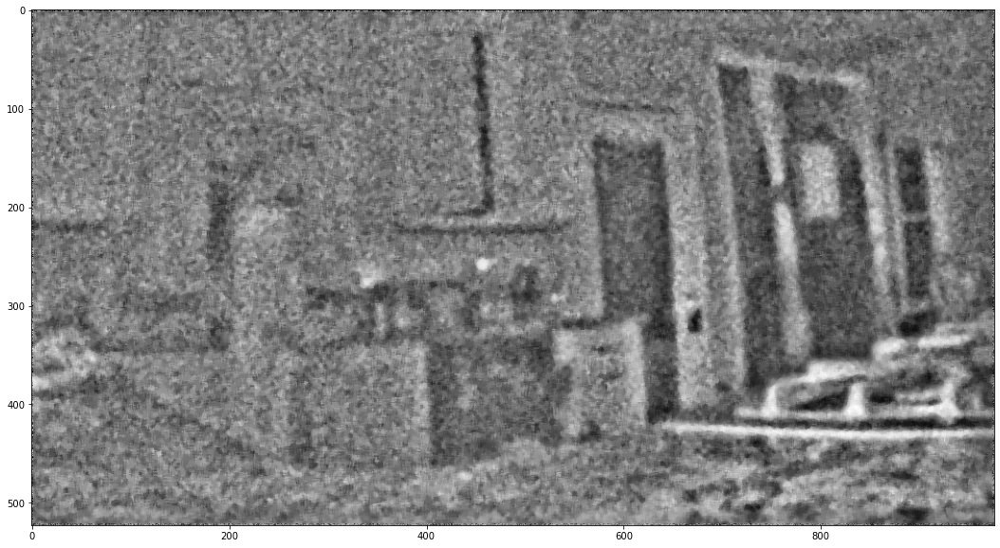

In [10]:
plt.figure(figsize=(20,10))
plt.imshow(median(img1,2),cmap='gray')

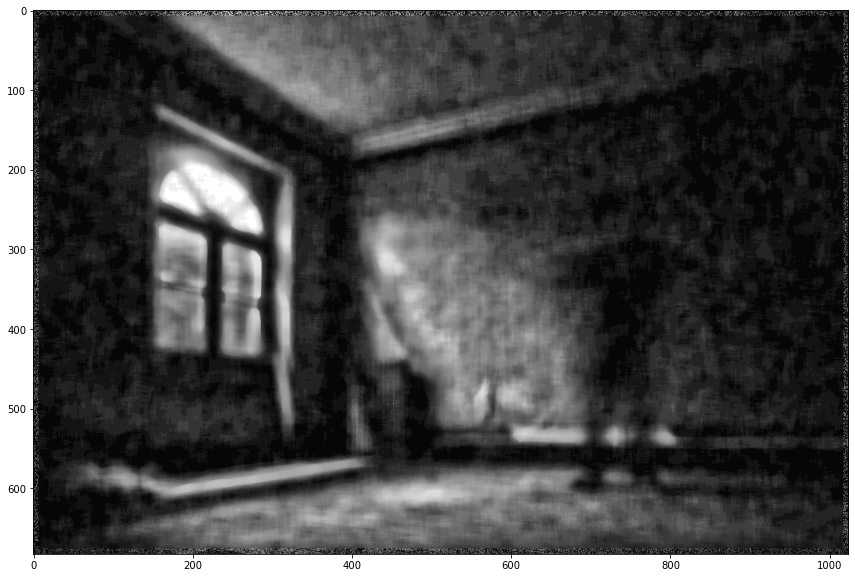

In [13]:
plt.figure(figsize=(20,10))
plt.imshow(median(img2,7),cmap='gray')

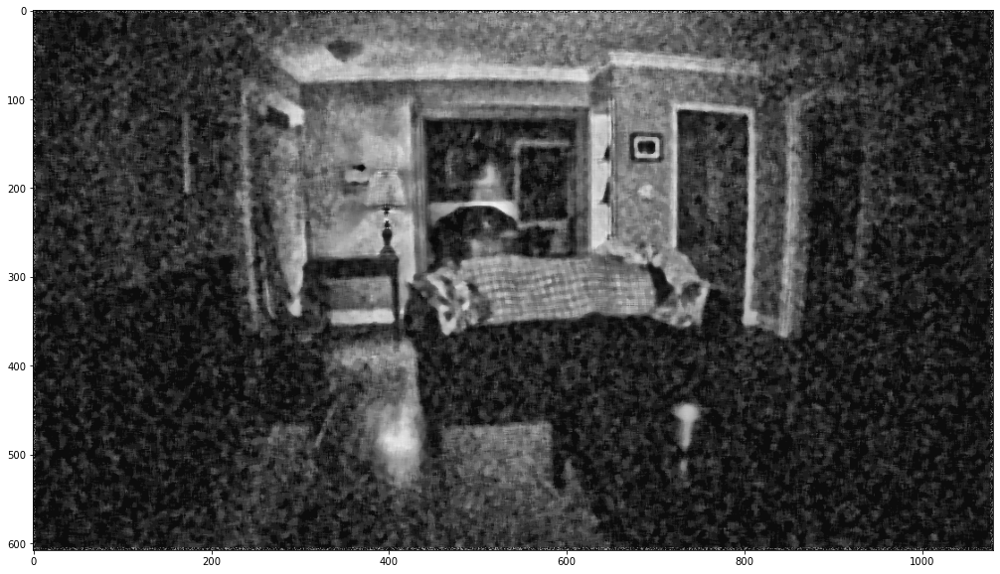

In [16]:
plt.figure(figsize=(20,10))
plt.imshow(median(img3,3),cmap='gray')

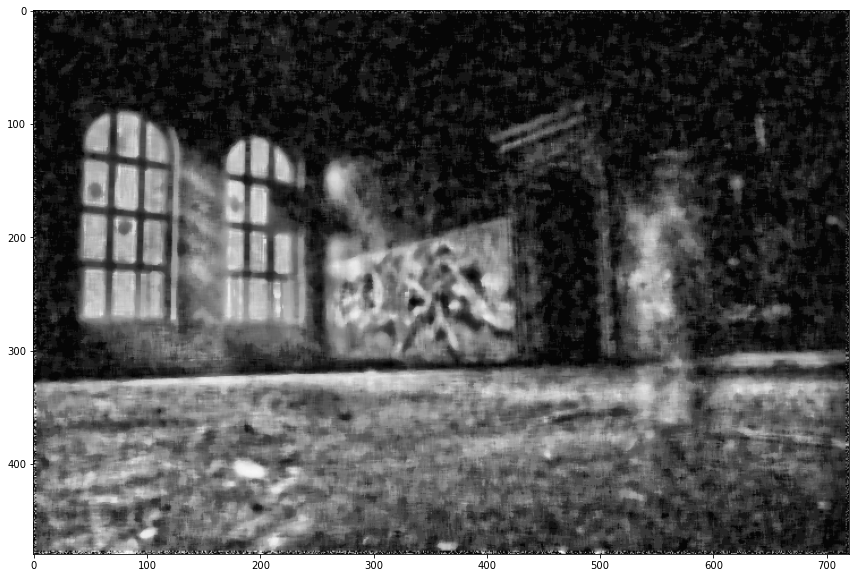

In [17]:
plt.figure(figsize=(20,10))
plt.imshow(median(img4,3),cmap='gray')

# median filter just good for second image